В этом ноутбуке:

1.   Скачиваем данные с kaggle
2.   Разбиваем на сеты неаугментированный набор
3.   Задаем собственную аугментацию 
4.   Задаем и тестируем функции для обучения/тестирования моделей

Все инициализированные здесь функции я вынесла в отдельные .py файлы и в ноутбуках обучения моделей просто вызываю их, чтобы не дублировать код.


# Importing packages

In [ ]:
!pip install torch-summary
!pip install torchmetrics

     |████████████████████████████████| 332 kB 5.2 MB/s 


In [ ]:
import os
from os.path import join
from pathlib import Path
import glob

import random
import numpy as np 
import pandas as pd

from PIL import Image
import torch
%load_ext tensorboard
from torch.utils import tensorboard as tboard
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

from collections import OrderedDict
from torch import nn
from torchsummary import summary
import torchmetrics as tm

import matplotlib.pyplot as plt


from __future__ import print_function, division
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [ ]:
def set_random_seed(rs):
    torch.manual_seed(rs)
    random.seed(rs)
    np.random.seed(rs)

In [ ]:
rs = 76

# Loading dataset from Kaggle

In [ ]:
from google.colab import drive
drive._mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


Переходим в рабочую директорию проекта.

In [ ]:
%cd "/content/gdrive/MyDrive/NSU-DNN_Course/In_the_blue_sea_white_foam"

/content/gdrive/MyDrive/NSU-DNN_Course/In_the_blue_sea_white_foam


In [ ]:
!ls

 checkpoints		        non-augmented_val_data.csv
 Fish_Dataset		        README.txt
 kaggle.json		        Segmentation_example_script.m
 labels_decoder.csv	        utils
 license.txt		        Went_to_the_bottom0.ipynb
 logs			       'Went_to_the_bottom (1).ipynb'
 NA_Fish_Dataset	        Went_to_the_bottom.ipynb
 non-augmented_test_data.csv   'Кодирование классов.ipynb'
 non-augmented_train_data.csv


При первом запуске - скачиваем данные с kaggle.  
Далее работаю с неагментированным набором.


Для os.environ["KAGGLE_CONFIG_DIR"] требуется указать полный путь до директории с файлом kaggle.json

In [ ]:
if "NA_Fish_Dataset" not in os.listdir():
    print("Downloading fish datasets from kaggle")
    !pip install kaggle
    os.environ["KAGGLE_CONFIG_DIR"] = "/content/gdrive/MyDrive/NSU-DNN_Course/In_the_blue_sea_white_foam"
    !kaggle datasets download -d crowww/a-large-scale-fish-dataset
    !unzip a-large-scale-fish-dataset.zip
else: 
    print("Fish dataset has already been downloaded")

Fish dataset has already been downloaded


In [ ]:
!ls

 checkpoints		        non-augmented_val_data.csv
 Fish_Dataset		        README.txt
 kaggle.json		        Segmentation_example_script.m
 labels_decoder.csv	        utils
 license.txt		        Went_to_the_bottom0.ipynb
 logs			       'Went_to_the_bottom (1).ipynb'
 NA_Fish_Dataset	        Went_to_the_bottom.ipynb
 non-augmented_test_data.csv   'Кодирование классов.ipynb'
 non-augmented_train_data.csv


# Data preprocessing


##***Reinventing the wheel (Part 1)***   
Прежде всего требуется создать файл с наименованием всех изображений и их лейблов.  
UPD: В этом блоке разбила на 3 набора.

In [ ]:
main_dir = Path(join('.', "NA_Fish_Dataset")) 
file_paths = list(
                filter(
                    lambda file_patch: any([ext in str(file_patch).lower() for ext in ['png', 'jpg']]),
                    main_dir.glob(join("**", r"*.*"))
                )
            )
del main_dir
labels = list(
            map(
                lambda file_path: os.path.split(os.path.split(file_path)[0])[1],
                file_paths
            )
        )

Картинки в sea bass и red sea bream - JPG.


In [ ]:
file_paths = pd.Series(file_paths, name="file_path", dtype=str)
labels = pd.Series(labels, name="label", dtype=str)

imgs_df = pd.merge(file_paths, labels, right_index=True, left_index=True) # Объединяем по индексам
del file_paths, labels
imgs_df.sample(n=5, random_state=rs)

,file_path,label
343,NA_Fish_Dataset/Shrimp/00045.png,Shrimp
193,NA_Fish_Dataset/Red Mullet/00041.png,Red Mullet
407,NA_Fish_Dataset/Trout/00013.png,Trout
388,NA_Fish_Dataset/Striped Red Mullet/00050.png,Striped Red Mullet
195,NA_Fish_Dataset/Red Mullet/00038.png,Red Mullet


### Label Encoding

Тут же закодируем лейблы, а потом разобьём на наборы.   
UPD: Это вторая версия ноутбука - в первой передавала строковые таргеты и их one-hot закодированное представление. Позже выяснилось, что CrossEntropyLoss может принимать представления таргетов в виде  векторов one-hot, так и номеров классов-лейблов, и в случае лейбл-кодирования, он сам применяет one-hot кодирование.  
Кроме того, когда дело дошло до метрик - one-hot закодированные таргеты требовалось преобразовывать в лейбл-закодированное представление. Поэтому работаем именно с лейбл-закодированным представлением лейблов.

#### Testing

In [ ]:
loss = nn.CrossEntropyLoss(reduction = 'mean')
t1 = torch.tensor([[1., 0., 0., 0., 0., 0., 0., 0., 0.]])
t2 = torch.tensor([[0., 0., 0., 0., 0., 0., 0., 0., 1.]])

In [ ]:
loss(t1, torch.tensor([8]))

tensor(2.3720)

In [ ]:
loss(t1, t2)

tensor(2.3720)

In [ ]:
loss(t1, t1)

tensor(1.3720)

In [ ]:
del loss, t1, t2

#### Label encoding

In [ ]:
labels_decoder_dict = dict(enumerate(imgs_df["label"].unique()))
labels_encoder_dict = dict(zip(labels_decoder_dict.values(), labels_decoder_dict.keys()))
labels_encoder_dict

{'Black Sea Sprat': 0,
 'Gilt Head Bream': 1,
 'Horse Mackerel': 2,
 'Red Mullet': 3,
 'Red Sea Bream': 4,
 'Sea Bass': 5,
 'Shrimp': 6,
 'Striped Red Mullet': 7,
 'Trout': 8}

In [ ]:
labels_decoder_pd = pd.DataFrame.from_dict(labels_decoder_dict,  orient="index", columns=["class_name"])
labels_decoder_pd.to_csv(join('.', "labels_decoder.csv"), index=True)
del labels_decoder_dict
labels_decoder_pd

,class_name
0,Black Sea Sprat
1,Gilt Head Bream
2,Horse Mackerel
3,Red Mullet
4,Red Sea Bream
5,Sea Bass
6,Shrimp
7,Striped Red Mullet
8,Trout


In [ ]:
del labels_decoder_pd

In [ ]:
imgs_df["label"].replace(to_replace=labels_encoder_dict, inplace=True)
imgs_df.sample(n=5, random_state=rs)

,file_path,label
343,NA_Fish_Dataset/Shrimp/00045.png,6
193,NA_Fish_Dataset/Red Mullet/00041.png,3
407,NA_Fish_Dataset/Trout/00013.png,8
388,NA_Fish_Dataset/Striped Red Mullet/00050.png,7
195,NA_Fish_Dataset/Red Mullet/00038.png,3


In [ ]:
del labels_encoder_dict

In [ ]:
imgs_df.shape # (429, 2)

(429, 2)

### Splitting data into sets

Берем 50% на обучение  
20% на валидацию  
и 30% на тестирование   
Каждый из этих наборов аугментируем и обучаемся/валидируемся и тестируемся на них.  
Требуется, чтобы было более-менее равномерное распределение по классам. Поэтому набираем выборки отдельно по каждому классу, чтобы в каждом наборе, гарантированно, был хотя бы один представитель каждого класса. 

In [ ]:
def train_val_test_split_by_classes(files_df, train_frac = 0.5, val_frac = 0.2, random_state=256):
    train_files_df = None
    val_files_df = None
    test_files_df = None
    for label in sorted(files_df["label"].unique()):
        print(label)
        files_df_ = files_df.loc[files_df["label"] == label].sample(frac = 1, random_state=random_state)
        train_shape = int(len(files_df_) * train_frac) + len(files_df_) % 2 # ceil
        val_shape = int(files_df_.shape[0] * val_frac)
        print(
            f"class '{label}': train_shp = {train_shape}, " +
            f"val_shp = {val_shape}, test_shape = {len(files_df_) - train_shape - val_shape}"
        )
        if train_files_df is None: 
            train_files_df = pd.DataFrame(files_df_[:train_shape].values, columns=files_df_.columns)
            val_files_df = pd.DataFrame(files_df_[train_shape:train_shape + val_shape].values, columns=files_df_.columns)
            test_files_df = pd.DataFrame(files_df_[train_shape + val_shape:].values, columns=files_df_.columns) 
        else: 
            train_files_df = train_files_df.append(files_df_[:train_shape], ignore_index=True)
            val_files_df = val_files_df.append(files_df_[train_shape:train_shape + val_shape], ignore_index=True) 
            test_files_df = test_files_df.append(files_df_[train_shape + val_shape:], ignore_index=True)
    
    print()
    print(
        "train_files_df distribution by classes:\t", 
        train_files_df["label"].value_counts().sort_index().to_dict(), 
        "\n\tsum:\t", train_files_df["label"].value_counts().sum()
    )    
    print(
        "val_files_df distribution by classes:\t", 
        val_files_df["label"].value_counts().sort_index().to_dict(), 
        "\n\tsum:\t", val_files_df["label"].value_counts().sum()
    )
    print(
        "test_files_df distribution by classes:\t", 
        test_files_df["label"].value_counts().sort_index().to_dict(), 
        "\n\tsum:\t", test_files_df["label"].value_counts().sum()
    )
    assert train_files_df["label"].value_counts().sum() +\
           val_files_df["label"].value_counts().sum() +\
           test_files_df["label"].value_counts().sum() ==  len(files_df)
    
    return  train_files_df, val_files_df, test_files_df

In [ ]:
train_imgs_df, val_imgs_df, test_imgs_df = train_val_test_split_by_classes(
    imgs_df, train_frac=0.5, val_frac=0.2, random_state=rs
)

0
class '0': train_shp = 25, val_shp = 10, test_shape = 15
1
class '1': train_shp = 25, val_shp = 10, test_shape = 15
2
class '2': train_shp = 25, val_shp = 10, test_shape = 15
3
class '3': train_shp = 25, val_shp = 10, test_shape = 15
4
class '4': train_shp = 25, val_shp = 9, test_shape = 15
5
class '5': train_shp = 25, val_shp = 10, test_shape = 15
6
class '6': train_shp = 25, val_shp = 10, test_shape = 15
7
class '7': train_shp = 25, val_shp = 10, test_shape = 15
8
class '8': train_shp = 15, val_shp = 6, test_shape = 9

train_files_df distribution by classes:	 {0: 25, 1: 25, 2: 25, 3: 25, 4: 25, 5: 25, 6: 25, 7: 25, 8: 15} 
	sum:	 215
val_files_df distribution by classes:	 {0: 10, 1: 10, 2: 10, 3: 10, 4: 9, 5: 10, 6: 10, 7: 10, 8: 6} 
	sum:	 85
test_files_df distribution by classes:	 {0: 15, 1: 15, 2: 15, 3: 15, 4: 15, 5: 15, 6: 15, 7: 15, 8: 9} 
	sum:	 129


In [ ]:
del imgs_df

In [ ]:
train_imgs_df.to_csv(join('.', "non-augmented_train_data.csv"), index=False)
val_imgs_df.to_csv(join('.', "non-augmented_val_data.csv"), index=False)
test_imgs_df.to_csv(join('.', "non-augmented_test_data.csv"), index=False)
del train_imgs_df, val_imgs_df, test_imgs_df

##***Reinventing the wheel (Part 2)***
(Можно запускать отдельно от 'Part 1')   
Готовим выборки для обучения, валидации и тестирования.  
Задаем преобразования и прочее.  
Туториал: https://pytorch.org/tutorials/beginner/data_loading_tutorial.html

In [ ]:
'''
labels_decoder_pd = pd.read_csv(join('.', "labels_decoder.csv"), index_col=0)
labels_decoder_pd
'''

### Dataset class

Вынесла в ./code/utils/dataset.py

In [ ]:
class Multiclass_Dataset(Dataset):
    def __init__(self, csv_file_patch, imgs_transforms=transforms.ToTensor()):
        """
        Args:
            csv_file_patch (string): Path to the csv file with annotations.
            imgs_transforms (callable, optional): Optional transforms to be applied to each sample.
        """
        data_df = pd.read_csv(csv_file_patch, index_col=None)
        self.patchs = data_df["file_path"].to_numpy()
        self.labels = data_df["label"].to_numpy()
        del data_df
        self.imgs_transforms = imgs_transforms

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        #'''
        image_pil = Image.open(self.patchs[idx])
        image_tensor = self.imgs_transforms(image_pil)
        label = self.labels[idx]
        #'''
        '''
        image_np = np.array(Image.open(self.patchs[idx]), dtype=np.float32)
        image_np =  image_np/ 255.0
        # Формат изображения в PIL - Channels Last ([Количество картинок в батче; Высота; Ширина; Количество каналов])
        # Перейдем к формату - Chennels First посредством изменения порядка измерений
        image_np = np.transpose(image_np, [2, 0, 1]) 
        image_tensor = torch.from_numpy(image_np)
        del image_np
        label = self.labels[idx]
        print(label)

        if self.imgs_transforms:
            image_tensor = self.imgs_transforms(image_tensor)
            # Вообще, трансформации могут включать в себя аугментации
            print(len(image_tensor))
            label = np.ones(shape=len(image_tensor), dtype=np.int32) * label 
            print(label)

        return image_tensor, label
        '''
        
        return {"image": image_tensor, "label": label}


### Thoughts about transformations

Оригинальный размер кадров -  1024x768 и 2832x2128.  
Предлагаю: 


1.   Для кастомной сетки - Использовать размер кадров 256x192, затем уменьшить его в 4 раза в самой сети, по аналогии с началом сети в ResNet50 - Сверткой 7x7 (stride=2) и maxPool 3x3 (stride=2) - итого размер кадров 64x48. 
2.   Для предобученных моделей - Использовать тот же размер снимков, что и в оригинальной статье (224x224).

UPD: По итогу и для кастомной сетки использую размер снимков 224x224



 
  
  
Вообще, на мелких рыбешках по типу Black Sea Sprat - большая часть снимка - стол (Да даже большую Trout могут фотографировть из под одного места). А в аугментированном наборе, помимо стола - еще и черные углы, которые появляются при повороте снимка. Снимки получаются очень неинформативные. А классификацию по столу что-то проводить не хочется.  
  
Предлагаемое решение: Применить зеркальный паддинг к изображению, затем поворот, обрезку по центру с чуть меньшим значением паддинга и заресайзить снимок до нужного размера. 


*   https://pytorch.org/vision/stable/transforms.html#torchvision.transforms.functional.rotate
*   https://pytorch.org/vision/stable/auto_examples/plot_transforms.html



Мне лень считать паддинг для поворота (чтобы избежать черных углов), поэтому просто берем 2 * ABS(H - W) для прямоугольных снимков. Если квадрат - половину стороны. 

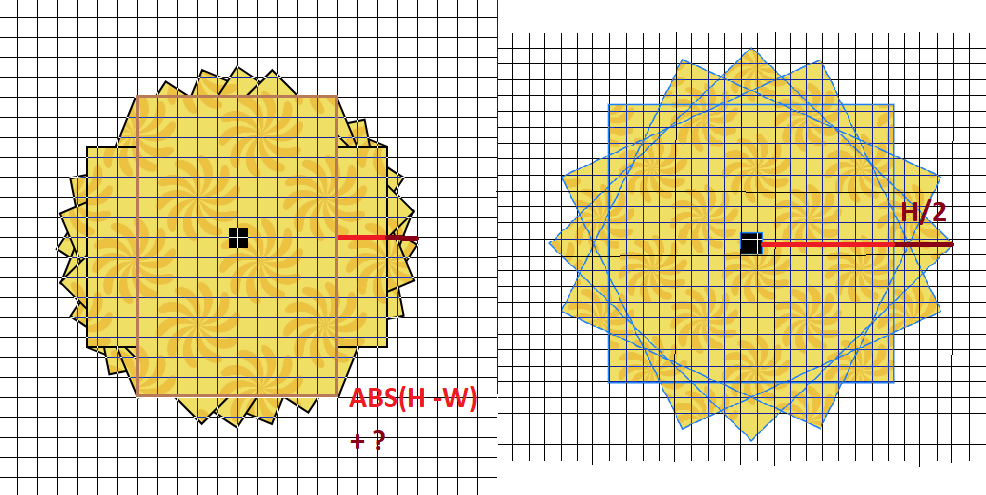

In [ ]:
class RandomRotationBySpace:
    """Rotate by one of the given angles."""

    def __init__(self, angles, interpolation=transforms.InterpolationMode.NEAREST, expand=False):
        self.angles = angles
        self.interpolation = interpolation
        self.expand = expand

    def __call__(self, img):
        return transforms.functional.rotate(
            img,
            angle=random.choice(self.angles),
            interpolation=self.interpolation,
            expand=self.expand
        )

In [ ]:
h, w = 192, 256

In [ ]:
imgs_transforms1 = transforms.Compose([
    transforms.Resize(size=(h, w), interpolation=transforms.InterpolationMode.BICUBIC),
    # Ну не нравится мне чернота, вот что хотите со мной делайте
    transforms.Pad(padding=2 * abs(h - w), padding_mode='symmetric'),

    # Делаем поворот:
    #     Интерполяция Bicubic возможна только для pil изображений
    #     expand=True не обрезает края картинки при повороте (размеры выходных изображений, при этом, различны)   
    # Использую реализацию, позволяющую сгенерировать конечное число аугментированных снимков для одного входа 
    RandomRotationBySpace(angles=np.arange(0., 360., 45.0), interpolation=transforms.InterpolationMode.BICUBIC, expand=False),
    # Итого - на 1 снимок приходится набор из 8 аугментированных снимков

    # Делаем обрезку снимков: 
    #     Есть рыбки, которые сфотографированы очень близко к краям снимков,  
    #     Поэтому предлагаю отсупить немного от края на значение отступа, соответствующему повороту в 90d 
    #     И заресайзить область до нужного размера (h, w)
    #     При центрировании, необходимость в expand в трансформации RandomRotation - отпадает
    #     Снимок со сравнением двух вариантов аугментаций (на данном этапе) приведен ниже
    #transforms.CenterCrop(size=(h, w)), 
    # or 
    transforms.CenterCrop(size=(h + abs(h - w), w + abs(h - w))), 
    transforms.Resize(size=(h, w), interpolation=transforms.InterpolationMode.BICUBIC),


    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomAutocontrast(p=0.5),  # Попробуем поправить снимки со вспышкой, чтобы это не являлось признаком классификации
    # И еще увеличваем размерность аугментированного набора в 4 раза
    transforms.ToTensor(), 

    #transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          #std=[0.229, 0.224, 0.225])
    # Итого - на снимок набор из 8 * 4 снимков
])

In [ ]:
side = 224

In [ ]:
imgs_transforms2 = transforms.Compose([
    # transforms.RandomSizedCrop(512),
    # transforms.RandomHorizontalFlip(),

    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.Pad(padding=side//2, padding_mode='symmetric'),
    RandomRotationBySpace(angles=np.arange(0., 360., 45.0), interpolation=transforms.InterpolationMode.BICUBIC, expand=False),
    #transforms.CenterCrop(size=side), 
    # or 
    transforms.CenterCrop(size=side + 0.25*side), 
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomAutocontrast(p=0.5), 
    transforms.ToTensor(), 
    #transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          #std=[0.229, 0.224, 0.225])
])

Первый коллаж - центрируюсь по размеру (h, w).  
Второй коллаж - делаю центрирование с отступом и понижаю разрешение до (h, w).  
По идее, 1 вариант, визуально, правильнее, хоть и головы у рыб иногда обрезаны.   
Я же далее буду пробовать 2 набор, так как края с дублирующимися рыбками все равно уйдут при свёртках в глубокой сети.  
P.S.: Размер уже другой.  
P.S. 2: Интересно, что предлагаемый аугментированный набор предтавляет собой смешанный вариант этих двух реализаций (применяется как центрирование (с обрезкой краев и, иногда, голов и хвостов), так и ресайз-реализация).  


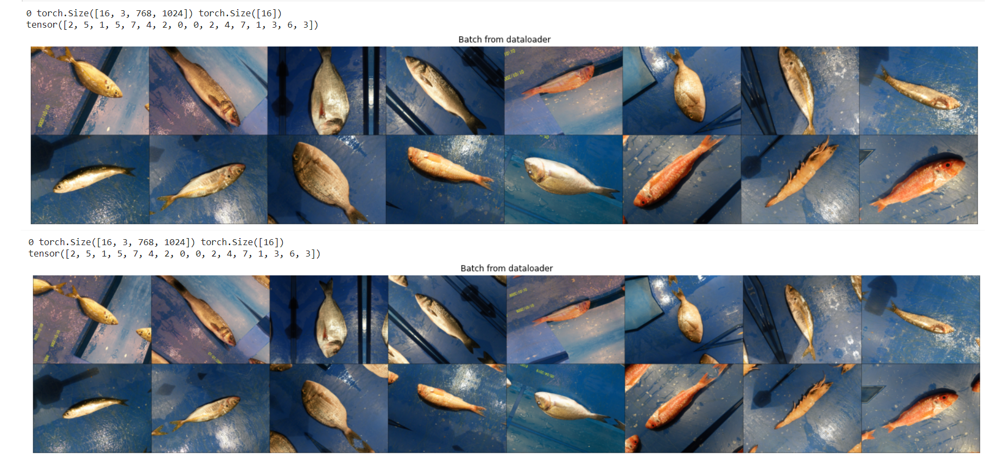

Что важно помнить при итерировании по дэйтасету - изначально, это просто оригинальный набор изображений, к которым были применены преобразования. Это не аугментированный набор из N * 32 снимков. Чтобы получить аугментированную выборку, требуется несколько раз (максимум 32) проитерироваться (внешним циклом) по всему дэйтасету из N снимков.
Будем придерживаться правила, что одна эпоха обучения должна проводится по всему набору изображений. Т.е. по N * 32.  
UPD: Так как логирую по эпохам в tensorboard - за две эпохи выполняю полный проход по дейтасету.

### Other utilities

In [ ]:
def show_images_batch(labels_decoder, sample_batch):
    if type(labels_decoder) is not pd.Series:
        labels_decoder_s = pd.Series(labels_decoder)
    else:
        labels_decoder_s = labels_decoder

    images_batch, labels_batch = \
        sample_batch['image'], sample_batch['label']
    grid = utils.make_grid(images_batch)
    plt.imshow(grid.numpy().transpose((1, 2, 0)))
    print("labels:", labels_decoder_s.iloc[labels_batch].values)
    plt.title('Batch from dataloader')

In [ ]:
def show_some_data_samples(dataloader, labels_decoder, nbatches=4):
    assert nbatches > 0
    nbatches -= 1
    for ibatch, sample_batch in enumerate(dataloader):
        print(ibatch, sample_batch['image'].size(), sample_batch['label'].size())
        plt.figure(figsize=(25, 40))
        show_images_batch(labels_decoder, sample_batch)
        plt.axis('off')

        if ibatch == nbatches:
            plt.show()
            break

Также понадобится метод для декодирования полученных из нейросети тензорных ответов в текстовый вид

In [ ]:
def get_label_for_enc_label_pred(labels_decoder, enc_label_pred_t):
    idx = ((enc_label_pred_t == enc_label_pred_t.max()).nonzero(as_tuple=True)[0])
    if type(labels_decoder) is not pd.Series:
        return labels_decoder[idx]
    else:
        return labels_decoder.iloc[idx].values[0]

In [ ]:
def get_labels_for_enc_labels_batch_pred(labels_decoder, enc_labels_pred_t):
    if type(labels_decoder) is not pd.Series:
        labels_decoder_s = pd.Series(labels_decoder)
    else:
        labels_decoder_s = labels_decoder

    idxs = np.zeros(len(enc_labels_pred_t))
    for idx, enc_label_t in enumerate(enc_labels_pred_t):
        idxs[idx] = ((enc_label_t == enc_label_t.max()).nonzero(as_tuple=True)[0])
    return labels_decoder_s.iloc[idxs].values

### Testing

In [ ]:
labels = os.listdir(join('.', "NA_Fish_Dataset"))
labels_s = pd.Series(labels)
labels_s

0       Black Sea Sprat
1       Gilt Head Bream
2        Horse Mackerel
3            Red Mullet
4         Red Sea Bream
5              Sea Bass
6                Shrimp
7    Striped Red Mullet
8                 Trout
dtype: object

In [ ]:
get_label_for_enc_label_pred(labels_s, torch.tensor([0, 0, 0, 0, 1, 0, 0, 0, 0], dtype=torch.float32))

'Red Sea Bream'

In [ ]:
get_label_for_enc_label_pred(labels, torch.Tensor([0, 0, 0, 0, 0, 0, 1, 0, 0]))

'Shrimp'

In [ ]:
batch = torch.Tensor(
    [[0, 0, 0, 0, 0, 0, 1, 0, 0],
    [0, 0, 0, 0, 1, 0, 0, 0, 0],
    [0, 1, 0, 0, 0, 0, 0, 0, 0],
    [0, 0, 0, 0, 0, 0, 0, 1, 0],
    [0, 0, 1, 0, 0, 0, 0, 0, 0],
    [0, 0, 0, 1, 0, 0, 0, 0, 0], 
    [0, 0, 0, 1, 0, 0, 0, 0, 0]]
)

In [ ]:
get_labels_for_enc_labels_batch_pred(labels, batch)

array(['Shrimp', 'Red Sea Bream', 'Gilt Head Bream', 'Striped Red Mullet',
       'Horse Mackerel', 'Red Mullet', 'Red Mullet'], dtype=object)

In [ ]:
del labels, labels_s, batch

In [ ]:
train_imgs_dataset1 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_train_data.csv"), imgs_transforms=imgs_transforms1)
train_imgs_dataset2 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_train_data.csv"), imgs_transforms=imgs_transforms2)

val_imgs_dataset1 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_val_data.csv"), imgs_transforms=imgs_transforms1)
val_imgs_dataset2 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_val_data.csv"), imgs_transforms=imgs_transforms2)

test_imgs_dataset1 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_test_data.csv"), imgs_transforms=imgs_transforms1)
test_imgs_dataset2 = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_test_data.csv"), imgs_transforms=imgs_transforms2)

In [ ]:
labels_decoder_s = pd.read_csv(join('.', "labels_decoder.csv"), index_col=0, squeeze=True)
labels_decoder_s

0       Black Sea Sprat
1       Gilt Head Bream
2        Horse Mackerel
3            Red Mullet
4         Red Sea Bream
5              Sea Bass
6                Shrimp
7    Striped Red Mullet
8                 Trout
Name: class_name, dtype: object

In [ ]:
len(train_imgs_dataset1), len(val_imgs_dataset1), len(test_imgs_dataset1)

(215, 85, 129)

In [ ]:
len(train_imgs_dataset1) * 32, len(val_imgs_dataset1) * 32, len(test_imgs_dataset1) * 32

(6880, 2720, 4128)

In [ ]:
6880//16, 2720//16, 4128//16

(430, 170, 258)

В предлагаемом аугментированном наборе 9000 снимков. А на одну рыбу приходится 20 снимков.

In [ ]:
6880 + 2720 + 4128

13728

-Юююююль, там рыбы...
РЫЫЫЫЫЫБЫ  

0 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Sea Bass' 'Horse Mackerel' 'Striped Red Mullet' 'Sea Bass'
 'Gilt Head Bream' 'Horse Mackerel' 'Black Sea Sprat' 'Red Sea Bream'
 'Black Sea Sprat' 'Red Mullet' 'Shrimp' 'Red Sea Bream' 'Black Sea Sprat'
 'Shrimp' 'Red Sea Bream' 'Trout']
1 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Gilt Head Bream' 'Horse Mackerel' 'Gilt Head Bream' 'Red Mullet'
 'Sea Bass' 'Horse Mackerel' 'Striped Red Mullet' 'Shrimp' 'Red Mullet'
 'Striped Red Mullet' 'Striped Red Mullet' 'Red Sea Bream' 'Trout'
 'Red Sea Bream' 'Shrimp' 'Gilt Head Bream']


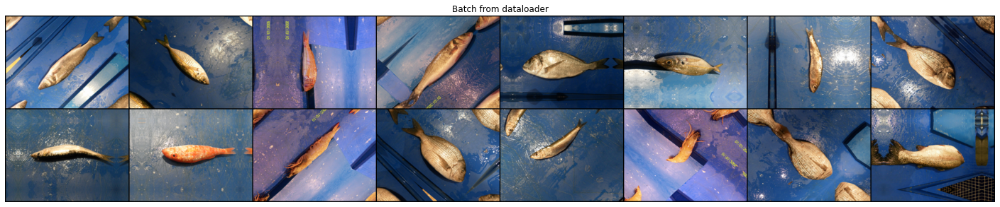

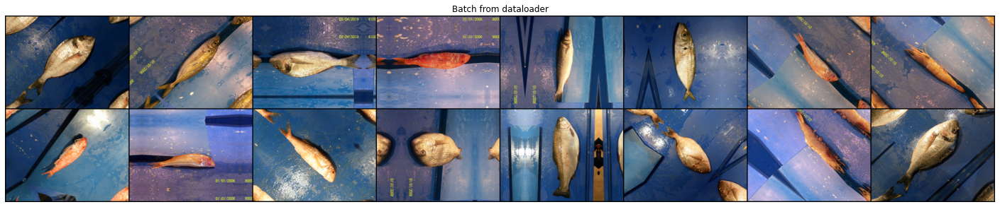

In [ ]:
#%%script false
set_random_seed(rs)
train_dataloader1 = DataLoader(train_imgs_dataset1, batch_size=16, shuffle=True)
show_some_data_samples(train_dataloader1, labels_decoder_s, 2)
del train_dataloader1

0 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Sea Bass' 'Horse Mackerel' 'Striped Red Mullet' 'Sea Bass'
 'Gilt Head Bream' 'Horse Mackerel' 'Black Sea Sprat' 'Red Sea Bream'
 'Black Sea Sprat' 'Red Mullet' 'Shrimp' 'Red Sea Bream' 'Black Sea Sprat'
 'Shrimp' 'Red Sea Bream' 'Trout']
1 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Gilt Head Bream' 'Horse Mackerel' 'Gilt Head Bream' 'Red Mullet'
 'Sea Bass' 'Horse Mackerel' 'Striped Red Mullet' 'Shrimp' 'Red Mullet'
 'Striped Red Mullet' 'Striped Red Mullet' 'Red Sea Bream' 'Trout'
 'Red Sea Bream' 'Shrimp' 'Gilt Head Bream']


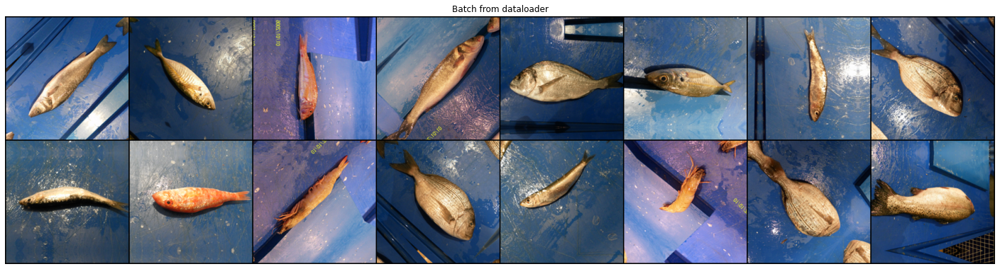

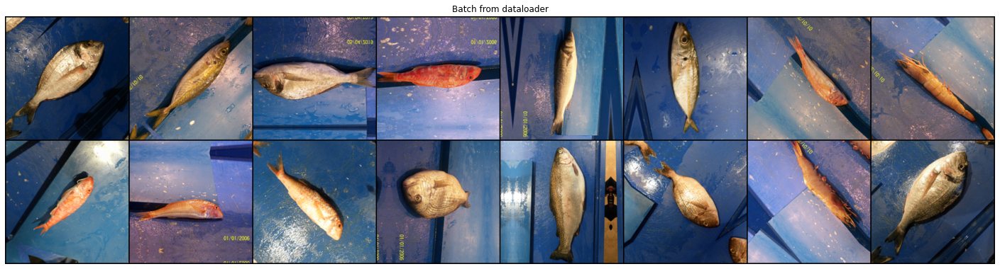

In [ ]:
#%%script false
set_random_seed(rs)
train_dataloader2 = DataLoader(train_imgs_dataset2, batch_size=16, shuffle=True)
show_some_data_samples(train_dataloader2, labels_decoder_s, 2)
del train_dataloader2

0 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Horse Mackerel' 'Sea Bass' 'Gilt Head Bream' 'Sea Bass'
 'Striped Red Mullet' 'Red Sea Bream' 'Horse Mackerel' 'Black Sea Sprat'
 'Black Sea Sprat' 'Horse Mackerel' 'Red Sea Bream' 'Striped Red Mullet'
 'Gilt Head Bream' 'Red Mullet' 'Shrimp' 'Red Mullet']
1 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Red Sea Bream' 'Black Sea Sprat' 'Striped Red Mullet' 'Gilt Head Bream'
 'Trout' 'Shrimp' 'Gilt Head Bream' 'Horse Mackerel' 'Shrimp'
 'Black Sea Sprat' 'Shrimp' 'Horse Mackerel' 'Red Mullet' 'Red Mullet'
 'Striped Red Mullet' 'Horse Mackerel']


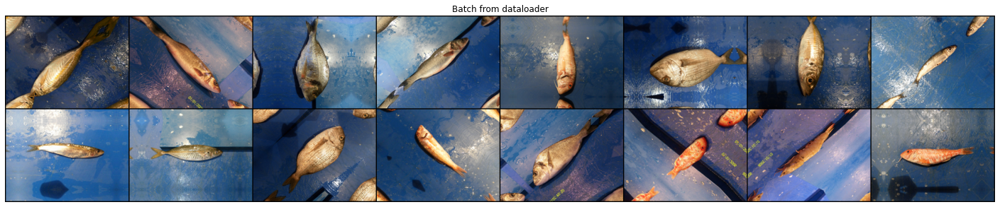

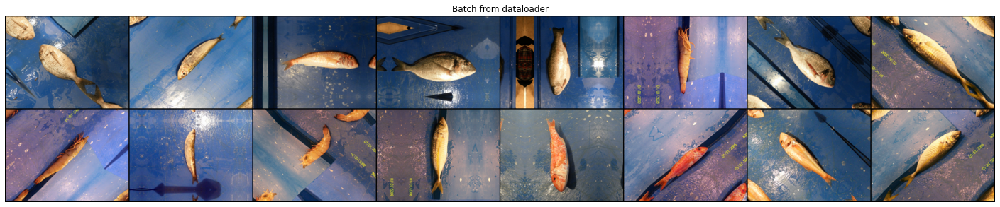

In [ ]:
#%%script false
set_random_seed(rs)
val_dataloader1 = DataLoader(val_imgs_dataset1, batch_size=16, shuffle=True)
show_some_data_samples(val_dataloader1, labels_decoder_s, 2)
del val_dataloader1

0 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Horse Mackerel' 'Sea Bass' 'Gilt Head Bream' 'Sea Bass'
 'Striped Red Mullet' 'Red Sea Bream' 'Horse Mackerel' 'Black Sea Sprat'
 'Black Sea Sprat' 'Horse Mackerel' 'Red Sea Bream' 'Striped Red Mullet'
 'Gilt Head Bream' 'Red Mullet' 'Shrimp' 'Red Mullet']
1 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Red Sea Bream' 'Black Sea Sprat' 'Striped Red Mullet' 'Gilt Head Bream'
 'Trout' 'Shrimp' 'Gilt Head Bream' 'Horse Mackerel' 'Shrimp'
 'Black Sea Sprat' 'Shrimp' 'Horse Mackerel' 'Red Mullet' 'Red Mullet'
 'Striped Red Mullet' 'Horse Mackerel']


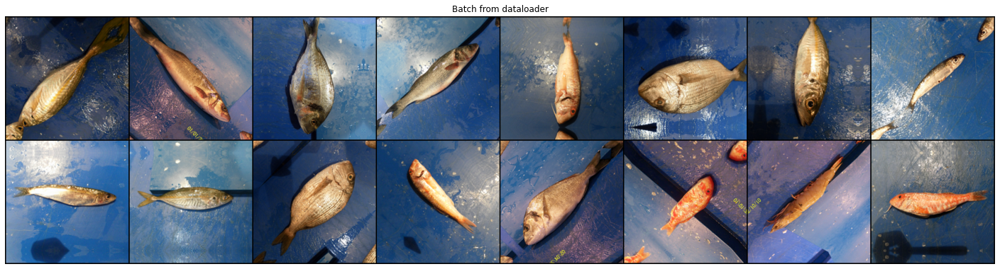

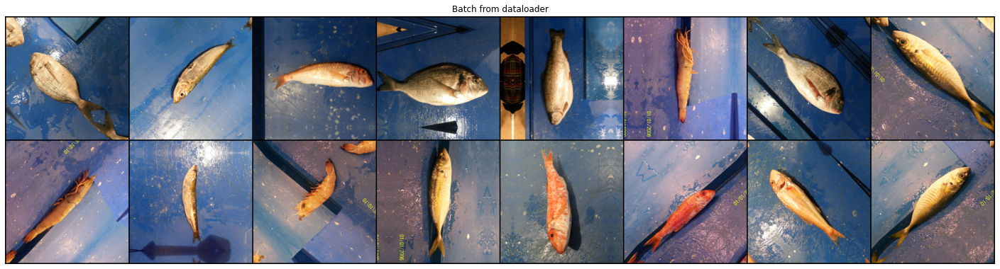

In [ ]:
#%%script false
set_random_seed(rs)
val_dataloader2 = DataLoader(val_imgs_dataset2, batch_size=16, shuffle=True)
show_some_data_samples(val_dataloader2, labels_decoder_s, 2)
del val_dataloader2

0 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Gilt Head Bream']
1 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Horse Mackerel' 'Horse Mackerel']
2 torch.Size([16, 3, 192, 256]) torch.Size([16])
labels: ['Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Red Mullet' 'Red Mu

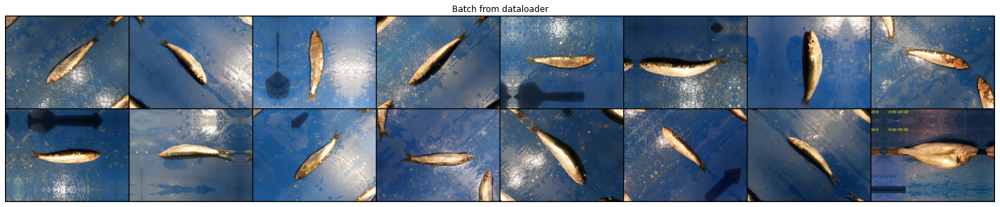

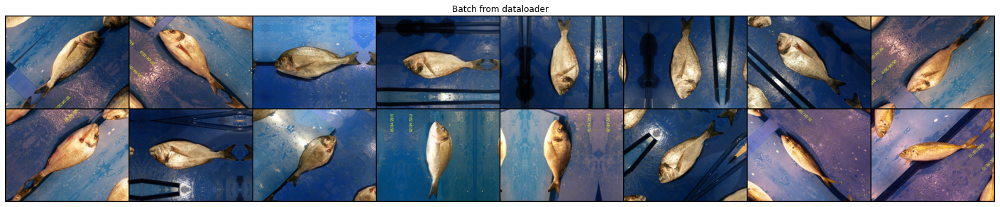

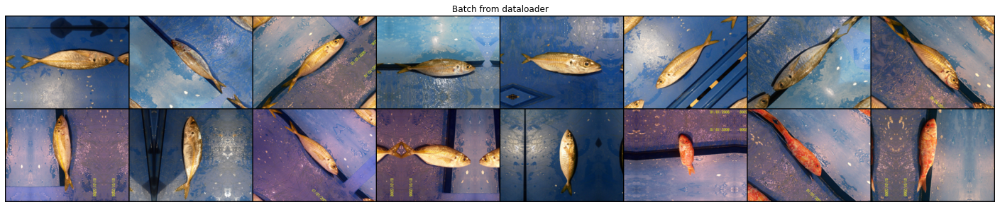

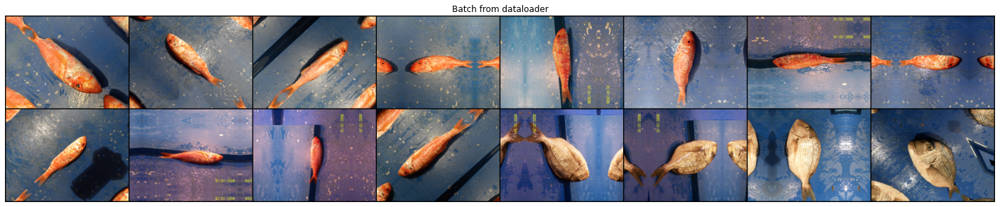

In [ ]:
#%%script false
set_random_seed(rs)
test_dataloader1 = DataLoader(test_imgs_dataset1, batch_size=16, shuffle=False)
show_some_data_samples(test_dataloader1, labels_decoder_s, 4)
del test_dataloader1

0 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Gilt Head Bream']
1 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Horse Mackerel' 'Horse Mackerel']
2 torch.Size([16, 3, 224, 224]) torch.Size([16])
labels: ['Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Red Mullet' 'Red Mu

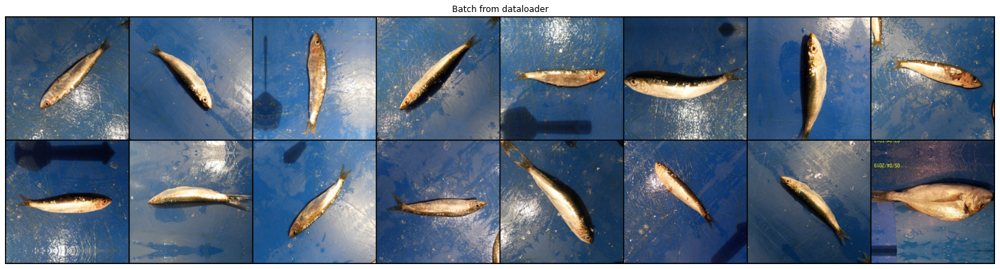

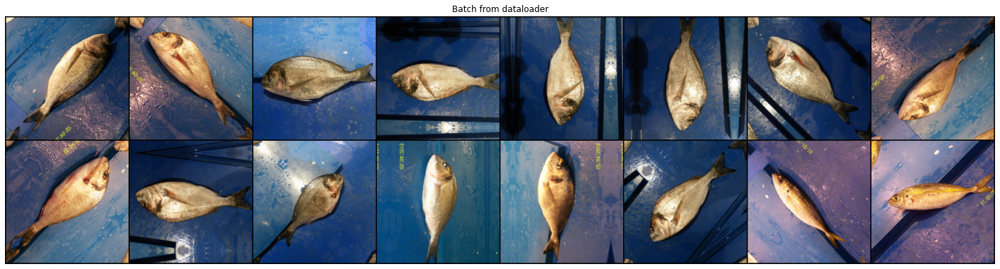

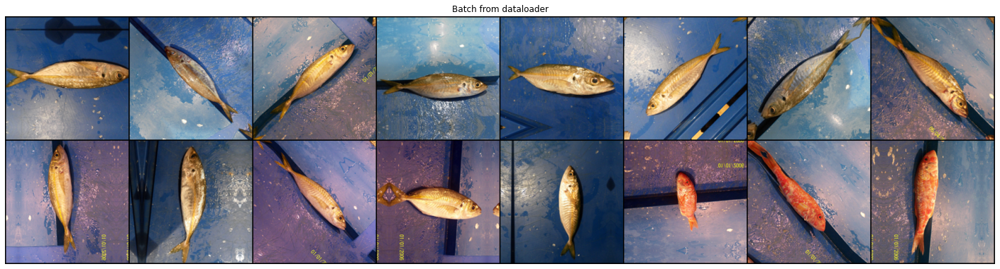

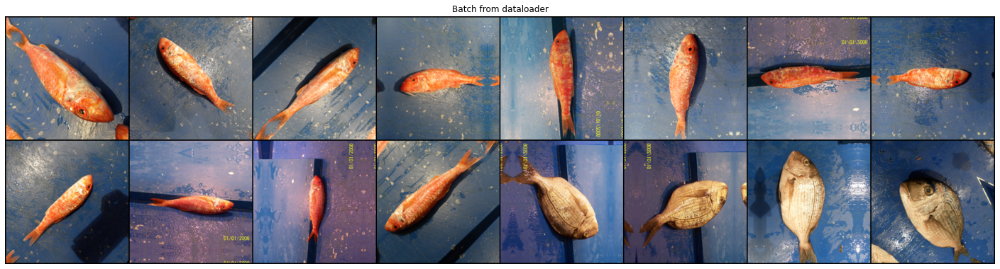

In [ ]:
#%%script false
set_random_seed(rs)
test_dataloader2 = DataLoader(test_imgs_dataset2, batch_size=16, shuffle=False)
show_some_data_samples(test_dataloader2, labels_decoder_s, 4)
del test_dataloader2

-Ну рыбы, ну и что.

Для квадратных снимков больше масштаб получился, так как отступ меньше беру.  
Мне этот набор больше нравится - рыбы очень крупные получаются. 

In [ ]:
del train_imgs_dataset1, val_imgs_dataset1, test_imgs_dataset1, train_imgs_dataset2, val_imgs_dataset2, test_imgs_dataset2
del imgs_transforms1, imgs_transforms2
del labels_decoder_s

# Network

Костыльная CNN-сеть с полносвязными слоями. 
Тут приведена только для тестирования функций обучения (хоть я и использовала их во второй лабе) и самой сетки. 

In [ ]:
class Multiclass_Classificator(nn.Module):
    def __init__(self, input_size=(768, 1024), nchannels=3, nclasses=9, nfilters=32, nblocks=6, end_avg_pool=True, pretrained_weights=None):
        super(Multiclass_Classificator, self).__init__()        
        assert type(input_size) in [int, tuple, list, np.ndarray]
      
        if type(input_size) is int:
            self.h, self.w = input_size, input_size 
        else:
            self.h, self.w = input_size
            self.h, self.w = int(self.h), int(self.w)
        #print(self.h, self.w)
        self.c = nfilters

        self.initial_layer = nn.Sequential(
            OrderedDict([
                (
                    f"conv7x7", 
                    nn.Conv2d(
                        in_channels=nchannels, out_channels=self.c,  
                        kernel_size=(7, 7),
                        stride=(2, 2), padding=(3, 3), padding_mode='zeros', 
                        bias=True
                    )
                ), (
                    f"prelu", 
                    nn.PReLU(num_parameters=self.c, init=0) # По сути, изначально это ReLu
                ), (
                    f"maxpool3x3",
                    torch.nn.MaxPool2d(kernel_size=(3, 3), stride=2)
                )
            ]) 
        )
        
        self.h = (int((self.h - 7 + 2 * 3)/2) + 1) // 2
        self.w = (int((self.w - 7 + 2 * 3)/2) + 1) // 2
        #print(self.h, self.w)


        # Первая свертка - stride=1
        # Вторая свёртка - stride=2
        iconv = 0
        feature_extraction_layer_list =  []
        for i in range(nblocks):
            feature_extraction_layer_list.append((
                f"conv3x3_{iconv}_s1", 
                nn.Conv2d(
                    in_channels=self.c, out_channels=nfilters * 2 ** iconv,
                    kernel_size=(3, 3), 
                    stride=(1, 1), padding=(1, 1), padding_mode='zeros',
                    bias=True
                )
            ))
            feature_extraction_layer_list.append((
                f"bnorm{iconv}_1", 
                nn.BatchNorm2d(num_features=nfilters * 2 ** iconv)
            ))
            feature_extraction_layer_list.append((
                f"prelu{iconv}_1",
                nn.PReLU(num_parameters=nfilters * 2 ** iconv, init=0)
            ))
            self.h = int((self.h - 3 + 2 * 1)/1) + 1
            self.w = int((self.w - 3 + 2 * 1)/1) + 1
            print(self.h, self.w)
            print(f"nfilters={nfilters * 2 ** iconv}")

            feature_extraction_layer_list.append((
                f"conv3x3_{iconv}_s2", 
                nn.Conv2d(
                    in_channels=nfilters * 2 ** iconv, out_channels=nfilters * 2 ** iconv,
                    kernel_size=(3, 3), 
                    stride=(2, 2), padding=(1, 1), padding_mode='zeros',
                    bias=True
                )
            ))
            feature_extraction_layer_list.append((
                f"bnorm{iconv}_2", 
                nn.BatchNorm2d(num_features=nfilters * 2 ** iconv)
            ))
            feature_extraction_layer_list.append((
                f"prelu{iconv}_2",
                nn.PReLU(num_parameters=nfilters * 2 ** iconv, init=0)
            ))
            self.h = int((self.h - 3 + 2 * 1)/2) + 1
            self.w = int((self.w - 3 + 2 * 1)/2) + 1
            print(self.h, self.w)
            print(f"nfilters={nfilters * 2 ** iconv}")
            self.c = nfilters * 2 ** iconv
            iconv += 1
        self.feature_extraction_layer = nn.Sequential(OrderedDict(feature_extraction_layer_list))
        
        # Нужно свернуть признаковое представление до размера C x 1 x 1
        # / C = nfilters * 2 ** (nblocks - 1)
        # Вынесем это а уровень гиперпараметра
        self.end_avg_pool = end_avg_pool
        final_layer_list =  []

        if self.end_avg_pool:
            final_layer_list.append((
                f"avgpool{self.h}x{self.w}", 
                nn.AvgPool2d(kernel_size=(self.h, self.w))
            ))
            self.h = 1
            self.w = 1
        
        self.linear1_in_features = self.h * self.w * self.c 

        final_layer_list.append((
            "flatten",
            nn.Flatten()
        ))
        final_layer_list.append((
            "linear1", 
            nn.Linear(
                in_features=self.linear1_in_features,
                out_features= nfilters * 2 ** nblocks,
                bias=True
            )
        ))
        final_layer_list.append((
            f"lrelu", 
            nn.LeakyReLU() 
        ))
        final_layer_list.append((
            "linear2", 
            nn.Linear(
                in_features=nfilters * 2 ** nblocks,
                out_features=nclasses,
                bias=True
            )
        ))
        '''
        final_layer_list.append((
            "softmax", 
            nn.Softmax()
        ))
        '''
    
        self.final_layer =  nn.Sequential(OrderedDict(final_layer_list))


    def forward(self, x):
        out = self.initial_layer(x)
        out = self.feature_extraction_layer(out)
        out = self.final_layer(out)

        return out

AdaptiveAvgPool2d был забыт, ы

linear1_in_features - количество нейронов в Dense-блоке.   
5 блоками в feature_extraction_layer привели изображение 384x512 к размеру 3x4.  
В первом случае - применяем AvgPool, во втором - увеличиваем кол-во нейронов в Dense-блоке. 

In [ ]:
model1 = Multiclass_Classificator(input_size=(384, 512), nchannels=3, nclasses=9, nfilters=16, nblocks=5, end_avg_pool=True)
print(model1.h, model1.w, model1.linear1_in_features)

96 128
nfilters=16
48 64
nfilters=16
48 64
nfilters=32
24 32
nfilters=32
24 32
nfilters=64
12 16
nfilters=64
12 16
nfilters=128
6 8
nfilters=128
6 8
nfilters=256
3 4
nfilters=256
1 1 256


In [ ]:
summary(model1, (3, 384, 512))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 95, 127]         --
|    └─Conv2d: 2-1                       [-1, 16, 192, 256]        2,368
|    └─PReLU: 2-2                        [-1, 16, 192, 256]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 95, 127]         --
├─Sequential: 1-2                        [-1, 256, 3, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 95, 127]         2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 95, 127]         32
|    └─PReLU: 2-6                        [-1, 16, 95, 127]         16
|    └─Conv2d: 2-7                       [-1, 16, 48, 64]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 48, 64]          32
|    └─PReLU: 2-9                        [-1, 16, 48, 64]          16
|    └─Conv2d: 2-10                      [-1, 32, 48, 64]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 48, 64]          64
|  

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 95, 127]         --
|    └─Conv2d: 2-1                       [-1, 16, 192, 256]        2,368
|    └─PReLU: 2-2                        [-1, 16, 192, 256]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 95, 127]         --
├─Sequential: 1-2                        [-1, 256, 3, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 95, 127]         2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 95, 127]         32
|    └─PReLU: 2-6                        [-1, 16, 95, 127]         16
|    └─Conv2d: 2-7                       [-1, 16, 48, 64]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 48, 64]          32
|    └─PReLU: 2-9                        [-1, 16, 48, 64]          16
|    └─Conv2d: 2-10                      [-1, 32, 48, 64]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 48, 64]          64
|  

In [ ]:
del model1

In [ ]:
model2 = Multiclass_Classificator(input_size=(384, 512), nchannels=3, nclasses=9, nfilters=16, nblocks=5, end_avg_pool=False)
print(model2.h, model2.w, model2.linear1_in_features)

96 128
nfilters=16
48 64
nfilters=16
48 64
nfilters=32
24 32
nfilters=32
24 32
nfilters=64
12 16
nfilters=64
12 16
nfilters=128
6 8
nfilters=128
6 8
nfilters=256
3 4
nfilters=256
3 4 3072


In [ ]:
summary(model2, (3, 384, 512))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 95, 127]         --
|    └─Conv2d: 2-1                       [-1, 16, 192, 256]        2,368
|    └─PReLU: 2-2                        [-1, 16, 192, 256]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 95, 127]         --
├─Sequential: 1-2                        [-1, 256, 3, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 95, 127]         2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 95, 127]         32
|    └─PReLU: 2-6                        [-1, 16, 95, 127]         16
|    └─Conv2d: 2-7                       [-1, 16, 48, 64]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 48, 64]          32
|    └─PReLU: 2-9                        [-1, 16, 48, 64]          16
|    └─Conv2d: 2-10                      [-1, 32, 48, 64]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 48, 64]          64
|  

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 95, 127]         --
|    └─Conv2d: 2-1                       [-1, 16, 192, 256]        2,368
|    └─PReLU: 2-2                        [-1, 16, 192, 256]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 95, 127]         --
├─Sequential: 1-2                        [-1, 256, 3, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 95, 127]         2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 95, 127]         32
|    └─PReLU: 2-6                        [-1, 16, 95, 127]         16
|    └─Conv2d: 2-7                       [-1, 16, 48, 64]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 48, 64]          32
|    └─PReLU: 2-9                        [-1, 16, 48, 64]          16
|    └─Conv2d: 2-10                      [-1, 32, 48, 64]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 48, 64]          64
|  

In [ ]:
del model2

## Utilities

In [ ]:
def train_one_epoch(model, train_dataloader, optimizer, loss, metric, iepoch, nepochs, nextend, log_each=20):
    # До этого определили размер батча для train_dataloader
    # Теперь надо пройти по всем батчам картинок для обучения одной эпохи
    nbatches = len(train_dataloader)
    total_loss_value = 0.0
    if metric:
        total_metric_value = 0.0

    for iextend in range(nextend):
        for ibatch, sample_batch in enumerate(train_dataloader):
            images, labels_true = sample_batch['image'], sample_batch['label']
            images = images.to(device)
            labels_true = labels_true.to(device)
            optimizer.zero_grad()
            enc_labels_pred = model(images)
            loss_value = loss(enc_labels_pred, labels_true)
            total_loss_value += loss_value.item()
            loss_value.backward()
            optimizer.step()

            if metric:
                if type(metric) is not nn.CrossEntropyLoss:
                    # Метрики принимают на вход вероятностные вектора
                    enc_labels_pred = nn.Softmax()(enc_labels_pred)
                metric_value = metric(enc_labels_pred, labels_true).item()
                total_metric_value += metric_value

            if (iextend * nbatches + ibatch + 1) % log_each == 0:
                print(
                    f"(Epoch {iepoch + 1}/{nepochs}-{iextend * nbatches + ibatch + 1}/{nbatches * nextend})\t",
                    f"Loss: {loss_value.item():.6f}\t", sep='', end=''
                )
                if metric:
                    print(f"Metric: {metric_value:.6f}", end='')
                print()
    total_loss_value /= nbatches * nextend
    print(
        f"Resulrts model training for epoch {iepoch + 1}/{nepochs}:\n\t",
        f"Loss\t: {total_loss_value:.6f}\t", sep='', end=''
    )
    if metric:
        total_metric_value /= nbatches * nextend
        print(f"Metric\t: {total_metric_value:.6f}")
        return total_loss_value, total_metric_value
    else:
        print()

    return total_loss_value

In [ ]:
def validate(model, valid_dataloader, loss, metric, nextend):
    nbatches = len(valid_dataloader)
    total_val_loss_value = 0.0
    if metric:
        total_val_metric_value = 0.0
    with torch.no_grad():
        for iextend in range(nextend):
            for ibatch, sample_batch in enumerate(valid_dataloader):
                images, labels_true = sample_batch['image'], sample_batch['label']
                images = images.to(device)
                labels_true = labels_true.to(device)
                enc_labels_pred = model(images)
                total_val_loss_value += loss(enc_labels_pred, labels_true).item()
                if metric:
                    if type(metric) is not nn.CrossEntropyLoss:
                        # Метрики принимают на вход вероятностные вектора
                        enc_labels_pred = nn.Softmax()(enc_labels_pred)
                    total_val_metric_value += metric(enc_labels_pred, labels_true).item()

        total_val_loss_value /= nbatches * nextend
        print(f'\tLoss val: {total_val_loss_value:.6f}\t', end='')

        if metric:
            total_val_metric_value /= nbatches * nextend
            print(f'Metric val: {total_val_metric_value:.6f}')
            return total_val_loss_value, total_val_metric_value
        else:
            print()
        return total_val_loss_value

In [ ]:
def evaluate(model, dataloader, metrics_list, nextend):
    nbatches = len(dataloader)

    total_metrics_value_t = torch.zeros(1, len(metrics_list)).to(device)
    with torch.no_grad():
        for iextend in range(nextend):
            for ibatch, sample_batch in enumerate(dataloader):
                images, labels_true = sample_batch['image'], sample_batch['label']
                images = images.to(device)
                labels_true = labels_true.to(device)
                enc_labels_pred = model(images)
                # Метрики принимают на вход вероятностные вектора
                enc_labels_pred_softmax = nn.Softmax()(enc_labels_pred)
                for idx, metric in enumerate(metrics_list):
                    if type(metric) is not nn.CrossEntropyLoss:
                        total_metrics_value_t[0][idx] += metric(enc_labels_pred_softmax, labels_true).item()
                    else:
                        total_metrics_value_t[0][idx] += metric(enc_labels_pred, labels_true).item()


        total_metrics_value_s = pd.DataFrame(
            data=total_metrics_value_t.to('cpu').numpy(),
            columns=[metric._get_name() for metric in metrics_list]
        ).iloc[0]

        return total_metrics_value_s / (nbatches * nextend)

In [ ]:
'''
def evaluate(model, dataloader, metrics_list, nextend):
    nbatches = len(dataloader)
    total_metrics_value = np.zeros(shape=len(metrics_list))

    with torch.no_grad():
        for iextend in range(nextend):
            for ibatch, sample_batch in enumerate(dataloader):
                images, labels_true = sample_batch['image'], sample_batch['label']
                images = images.to(device)
                labels_true = labels_true.to(device)
                enc_labels_pred = model.forward(images)
                # Метрики принимают на вход вероятностные вектора
                enc_labels_pred = nn.Softmax()(enc_labels_pred)

                for idx, metric in enumerate(metrics_list):
                    total_metrics_value[idx] += metric(enc_labels_pred, labels_true).item()

        return total_metrics_value / nbatches * nextend
'''

# Preparation for the training

In [ ]:
side = 224

In [ ]:
imgs_transforms = transforms.Compose([
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.Pad(padding=side//2, padding_mode='symmetric'),
    RandomRotationBySpace(angles=np.arange(0., 360., 45.0), interpolation=transforms.InterpolationMode.BICUBIC, expand=False),
    #transforms.CenterCrop(size=side), 
    # or 
    transforms.CenterCrop(size=side + 0.25*side), 
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomAutocontrast(p=0.5), 
    transforms.ToTensor(), 
    #transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          #std=[0.229, 0.224, 0.225])
])

In [ ]:
labels_s = pd.Series(os.listdir(join('.', "NA_Fish_Dataset")))
train_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_train_data.csv"), imgs_transforms=imgs_transforms)
val_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_val_data.csv"), imgs_transforms=imgs_transforms)
test_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_test_data.csv"), imgs_transforms=imgs_transforms)
len(train_imgs_dataset), len(val_imgs_dataset), len(test_imgs_dataset)

(215, 85, 129)

In [ ]:
set_random_seed(rs)
train_dataloader = DataLoader(train_imgs_dataset, batch_size=16, shuffle=True)
val_dataloader = DataLoader(val_imgs_dataset, batch_size=16, shuffle=True)
test_dataloader = DataLoader(test_imgs_dataset, batch_size=16, shuffle=True)
len(train_dataloader), len(val_dataloader), len(test_dataloader)

(14, 6, 9)

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [ ]:
model = Multiclass_Classificator(input_size=(224, 224), nchannels=3, nclasses=9, nfilters=32, nblocks=5, end_avg_pool=True).to(device)

56 56
nfilters=32
28 28
nfilters=32
28 28
nfilters=64
14 14
nfilters=64
14 14
nfilters=128
7 7
nfilters=128
7 7
nfilters=256
4 4
nfilters=256
4 4
nfilters=512
2 2
nfilters=512


In [ ]:
loss = nn.CrossEntropyLoss(reduction = 'mean')
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [ ]:
exp_name = "test"
logdir = Path(join('.', "logs_eval", exp_name))
logdir.mkdir(exist_ok=True, parents=True)
writer = tboard.SummaryWriter(logdir)

# Model training 

In [ ]:
best_val_loss_value = np.inf
iepoch_best_model = 0
nepochs = 8
nextend = 4
# nextend = 32, но тогда для одной эпохи залогируемся всего раз
# Вместо этого уменьшим nextend и увеличим количество эпох
# Когда буду "на дне", попробую просто увеличить размер батча 
for iepoch in range(0, nepochs):
    total_loss_value = train_one_epoch(model, train_dataloader, optimizer, loss, None, iepoch, nepochs, nextend=nextend)
    writer.add_scalar(f'train/loss', total_loss_value, global_step=iepoch)
    total_val_loss_value = validate(model, val_dataloader, loss, None, nextend=nextend)
    writer.add_scalar(f'val/loss', total_val_loss_value, global_step=iepoch)

    is_best = total_val_loss_value < best_val_loss_value
    if is_best:
        print(f"val_loss_value improved from {best_val_loss_value:.6f} to {total_val_loss_value:.6f}, saving model...")
        best_val_loss_value = total_val_loss_value
        iepoch_best_model = iepoch
        torch.save(model.state_dict(), join('.', 'checkpoints', f'{exp_name}.pth'))
    else:
      print(f"val_loss_value did not improve from {best_val_loss_value:.6f} on epoch {iepoch_best_model}")

(Epoch 1/8-20/56)	Loss: 2.074053	
(Epoch 1/8-40/56)	Loss: 1.888766	
Resulrts model training for epoch 1/8:
	Loss	: 1.995445	
	Loss val: 1.759230	
val_loss_value improved from inf to 1.7592297792434692, saving model...
(Epoch 2/8-20/56)	Loss: 1.600289	
(Epoch 2/8-40/56)	Loss: 1.167829	
Resulrts model training for epoch 2/8:
	Loss	: 1.435881	
	Loss val: 1.337126	
val_loss_value improved from 1.7592297792434692 to 1.337126299738884, saving model...
(Epoch 3/8-20/56)	Loss: 1.039462	
(Epoch 3/8-40/56)	Loss: 0.663836	
Resulrts model training for epoch 3/8:
	Loss	: 0.953735	
	Loss val: 1.109449	
val_loss_value improved from 1.337126299738884 to 1.1094487731655438, saving model...
(Epoch 4/8-20/56)	Loss: 0.768804	
(Epoch 4/8-40/56)	Loss: 0.995652	
Resulrts model training for epoch 4/8:
	Loss	: 0.720891	
	Loss val: 1.107268	
val_loss_value improved from 1.1094487731655438 to 1.1072681322693825, saving model...
(Epoch 5/8-20/56)	Loss: 0.627117	
(Epoch 5/8-40/56)	Loss: 0.473022	
Resulrts model tr

# Model testing

In [ ]:
nclasses = 9
metrics_list = [
                tm.Accuracy(threshold=0.5, num_classes=nclasses),
                tm.AUROC(num_classes=nclasses)
                ]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `AUROC` will save all targets and predictions in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)


In [ ]:
model.load_state_dict(torch.load(join('.', 'checkpoints', f'{exp_name}.pth')))

<All keys matched successfully>

In [ ]:
evaluate(model, test_dataloader, metrics_list, nextend=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: No positive samples in targets, true positive value should be meaningless. Returning zero tensor in true positive score
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: No negative samples in targets, false positive value should be meaningless. Returning zero tensor in false positive score
  warnings.warn(*args, **kwargs)


array([0.84722222, 0.79610582])

In [ ]:
%tensorboard --logdir "./logs/test"

<IPython.core.display.Javascript object>